In [50]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

sns.set_theme()

In [51]:
Nx = 8
Ny = 8
Nt = 15000

tf = 10

deltaX = 1/(Nx - 1)
deltaY = 1/(Ny - 1)
deltaT = tf/(Nt - 1)

In [52]:
x = np.arange(0, 1.01, deltaX)
y = np.arange(0, 1.01, deltaY)
t = np.arange(0, tf + deltaT, deltaT)

X, Y = np.meshgrid(x, y)

In [53]:
sx = deltaT/deltaX**2
sy = deltaT/deltaY**2

In [54]:
wij_1 = np.zeros((Nx, Ny))
wij = np.zeros((Nx, Ny))

wij[:, 0] = 1  # Left boundary
wij[:, -1] = 1  # Right boundary
wij[0, :] = 1  # Top boundary
wij[-1, :] = 1  # Bottom boundary

Animation size has reached 20986017 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


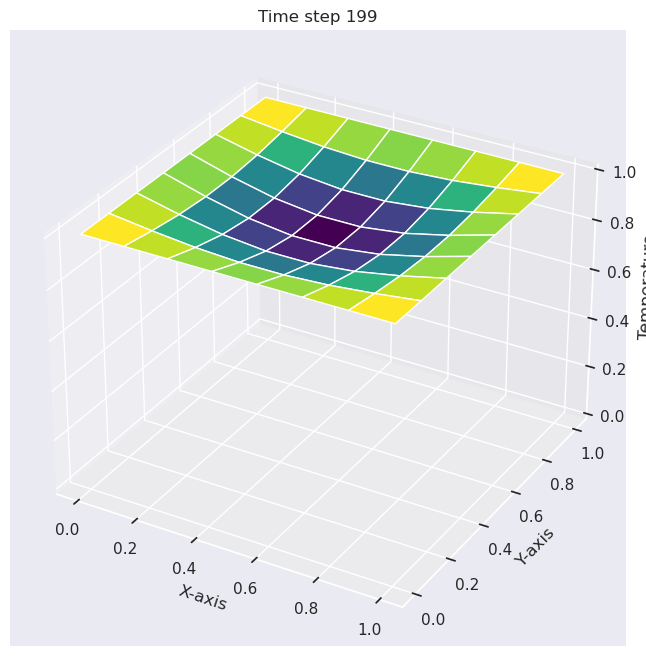

In [55]:
# Set up the figure and 3D axis
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Function to update the plot for each frame
def update(frame):
    global wij
    wij_1 = np.copy(wij)
    for i in range(1, Nx-1):
        for j in range(1, Ny-1):
            wij[i, j] = wij_1[i, j] + sx*(wij_1[i+1, j] - 2*wij_1[i, j] + wij_1[i-1, j]) + sy*(wij_1[i, j+1] - 2*wij_1[i, j] + wij_1[i, j-1])
    
    # Reapply boundary conditions
    wij[:, 0] = 1  # Left boundary
    wij[:, -1] = 1  # Right boundary
    wij[0, :] = 1  # Top boundary
    wij[-1, :] = 1  # Bottom boundary
    
    ax.clear()
    surf = ax.plot_surface(X, Y, wij, cmap='viridis')
    ax.set_zlim(0, 1)
    ax.set_title(f'Time step {frame}')
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
    ax.set_zlabel('Temperature')
    return surf,

# Create the animation
anim = FuncAnimation(fig, update, frames=200, interval=10, blit=False, repeat=False)

# Display the animation in
HTML(anim.to_jshtml())

/tmp/ipykernel_657/1671708428.py:31: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for coll in contour.collections:
/tmp/ipykernel_657/1671708428.py:44: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  return contour.collections
Animation size has reached 20994567 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


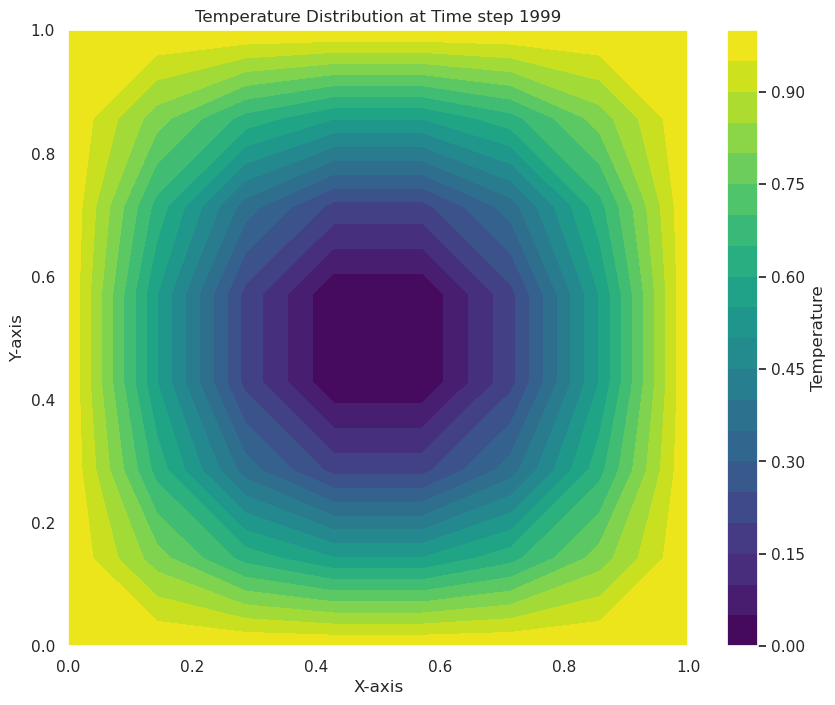

In [59]:
wij_1 = np.zeros((Nx, Ny))
wij = np.zeros((Nx, Ny))

wij[:, 0] = 1  # Left boundary
wij[:, -1] = 1  # Right boundary
wij[0, :] = 1  # Top boundary
wij[-1, :] = 1  # Bottom boundary

# Set up the figure for contour plotting
fig, ax = plt.subplots(figsize=(10, 8))

# Initialize the contour plot
contour = ax.contourf(X, Y, wij, levels=20, cmap='viridis')
plt.colorbar(contour, ax=ax, label='Temperature')

# Function to update the plot for each frame
def update(frame):
    global wij, contour
    wij_1 = np.copy(wij)
    for i in range(1, Nx-1):
        for j in range(1, Ny-1):
            wij[i, j] = wij_1[i, j] + sx*(wij_1[i+1, j] - 2*wij_1[i, j] + wij_1[i-1, j]) + sy*(wij_1[i, j+1] - 2*wij_1[i, j] + wij_1[i, j-1])
    
    # Reapply boundary conditions
    wij[:, 0] = 1  # Left boundary
    wij[:, -1] = 1  # Right boundary
    wij[0, :] = 1  # Top boundary
    wij[-1, :] = 1  # Bottom boundary
    
    # Clear the previous contours
    for coll in contour.collections:
        coll.remove()
    
    # Update the contour plot
    contour = ax.contourf(X, Y, wij, levels=20, cmap='viridis')
    ax.set_title(f'Temperature Distribution at Time step {frame}')
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
    
    # Ensure proper axis limits
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    
    return contour.collections

# Create the animation
anim = FuncAnimation(fig, update, frames=2000, interval=3, blit=False, repeat=False)

# Display the animation
HTML(anim.to_jshtml())